In [1]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns

from ucimlrepo import fetch_ucirepo

from scipy import stats

import os

In [2]:
# Print all rows and columns

pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

# Import Dataset

In [3]:
# fetch dataset 
communities_and_crime = fetch_ucirepo(id=183)
  
# data (as pandas dataframes) 
X = communities_and_crime.data.features
y = communities_and_crime.data.targets

In [4]:
X.head(20)

,state,county,community,communityname,fold,population,householdsize,racepctblack,racePctWhite,racePctAsian,racePctHisp,agePct12t21,agePct12t29,agePct16t24,agePct65up,numbUrban,pctUrban,medIncome,pctWWage,pctWFarmSelf,pctWInvInc,pctWSocSec,pctWPubAsst,pctWRetire,medFamInc,perCapInc,whitePerCap,blackPerCap,indianPerCap,AsianPerCap,OtherPerCap,HispPerCap,NumUnderPov,PctPopUnderPov,PctLess9thGrade,PctNotHSGrad,PctBSorMore,PctUnemployed,PctEmploy,PctEmplManu,PctEmplProfServ,PctOccupManu,PctOccupMgmtProf,MalePctDivorce,MalePctNevMarr,FemalePctDiv,TotalPctDiv,PersPerFam,PctFam2Par,PctKids2Par,PctYoungKids2Par,PctTeen2Par,PctWorkMomYoungKids,PctWorkMom,NumIlleg,PctIlleg,NumImmig,PctImmigRecent,PctImmigRec5,PctImmigRec8,PctImmigRec10,PctRecentImmig,PctRecImmig5,PctRecImmig8,PctRecImmig10,PctSpeakEnglOnly,PctNotSpeakEnglWell,PctLargHouseFam,PctLargHouseOccup,PersPerOccupHous,PersPerOwnOccHous,PersPerRentOccHous,PctPersOwnOccup,PctPersDenseHous,PctHousLess3BR,MedNumBR,HousVacant,PctHousOccup,PctHousOwnOcc,PctVacantBoarded,PctVacMore6Mos,MedYrHousBuilt,PctHousNoPhone,PctWOFullPlumb,OwnOccLowQuart,OwnOccMedVal,OwnOccHiQuart,RentLowQ,RentMedian,RentHighQ,MedRent,MedRentPctHousInc,MedOwnCostPctInc,MedOwnCostPctIncNoMtg,NumInShelters,NumStreet,PctForeignBorn,PctBornSameState,PctSameHouse85,PctSameCity85,PctSameState85,LemasSwornFT,LemasSwFTPerPop,LemasSwFTFieldOps,LemasSwFTFieldPerPop,LemasTotalReq,LemasTotReqPerPop,PolicReqPerOffic,PolicPerPop,RacialMatchCommPol,PctPolicWhite,PctPolicBlack,PctPolicHisp,PctPolicAsian,PctPolicMinor,OfficAssgnDrugUnits,NumKindsDrugsSeiz,PolicAveOTWorked,LandArea,PopDens,PctUsePubTrans,PolicCars,PolicOperBudg,LemasPctPolicOnPatr,LemasGangUnitDeploy,LemasPctOfficDrugUn,PolicBudgPerPop
0,8,?,?,Lakewoodcity,1,0.19,0.33,0.02,0.90,0.12,0.17,0.34,0.47,0.29,0.32,0.20,1.00,0.37,0.72,0.34,0.60,0.29,0.15,0.43,0.39,0.40,0.39,0.32,0.27,0.27,0.36,0.41,0.08,0.19,0.10,0.18,0.48,0.27,0.68,0.23,0.41,0.25,0.52,0.68,0.40,0.75,0.75,0.35,0.55,0.59,0.61,0.56,0.74,0.76,0.04,0.14,0.03,0.24,0.27,0.37,0.39,0.07,0.07,0.08,0.08,0.89,0.06,0.14,0.13,0.33,0.39,0.28,0.55,0.09,0.51,0.5,0.21,0.71,0.52,0.05,0.26,0.65,0.14,0.06,0.22,0.19,0.18,0.36,0.35,0.38,0.34,0.38,0.46,0.25,0.04,0.00,0.12,0.42,0.50,0.51,0.64,0.03,0.13,0.96,0.17,0.06,0.18,0.44,0.13,0.94,0.93,0.03,0.07,0.1,0.07,0.02,0.57,0.29,0.12,0.26,0.20,0.06,0.04,0.9,0.5,0.32,0.14
1,53,?,?,Tukwilacity,1,0.00,0.16,0.12,0.74,0.45,0.07,0.26,0.59,0.35,0.27,0.02,1.00,0.31,0.72,0.11,0.45,0.25,0.29,0.39,0.29,0.37,0.38,0.33,0.16,0.30,0.22,0.35,0.01,0.24,0.14,0.24,0.30,0.27,0.73,0.57,0.15,0.42,0.36,1.00,0.63,0.91,1.00,0.29,0.43,0.47,0.60,0.39,0.46,0.53,0.00,0.24,0.01,0.52,0.62,0.64,0.63,0.25,0.27,0.25,0.23,0.84,0.10,0.16,0.10,0.17,0.29,0.17,0.26,0.20,0.82,0.0,0.02,0.79,0.24,0.02,0.25,0.65,0.16,0.00,0.21,0.20,0.21,0.42,0.38,0.40,0.37,0.29,0.32,0.18,0.00,0.00,0.21,0.50,0.34,0.60,0.52,?,?,?,?,?,?,?,?,?,?,?,?,?,?,?,?,?,0.02,0.12,0.45,?,?,?,?,0.00,?
2,24,?,?,Aberdeentown,1,0.00,0.42,0.49,0.56,0.17,0.04,0.39,0.47,0.28,0.32,0.00,0.00,0.30,0.58,0.19,0.39,0.38,0.40,0.84,0.28,0.27,0.29,0.27,0.07,0.29,0.28,0.39,0.01,0.27,0.27,0.43,0.19,0.36,0.58,0.32,0.29,0.49,0.32,0.63,0.41,0.71,0.70,0.45,0.42,0.44,0.43,0.43,0.71,0.67,0.01,0.46,0.00,0.07,0.06,0.15,0.19,0.02,0.02,0.04,0.05,0.88,0.04,0.20,0.20,0.46,0.52,0.43,0.42,0.15,0.51,0.5,0.01,0.86,0.41,0.29,0.30,0.52,0.47,0.45,0.18,0.17,0.16,0.27,0.29,0.27,0.31,0.48,0.39,0.28,0.00,0.00,0.14,0.49,0.54,0.67,0.56,?,?,?,?,?,?,?,?,?,?,?,?,?,?,?,?,?,0.01,0.21,0.02,?,?,?,?,0.00,?
3,34,5,81440,Willingborotownship,1,0.04,0.77,1.00,0.08,0.12,0.10,0.51,0.50,0.34,0.21,0.06,1.00,0.58,0.89,0.21,0.43,0.36,0.20,0.82,0.51,0.36,0.40,0.39,0.16,0.25,0.36,0.44,0.01,0.10,0.09,0.25,0.31,0.33,0.71,0.36,0.45,0.37,0.39,0.34,0.45,0.49,0.44,0.75,0.65,0.54,0.83,0.65,0.85,0.86,0.03,0.33,0.02,0.11,0.20,0.30,0.31,0.05,0.08,0.11,0.11,0.81,0.08,0.56,0.62,0.85,0.77,1.00,0.94,0.12,0.01,0.5,0.01,0.97,0.96,0.60,0.47,0.52,0.11,0.11,0.24,0.21,0.19,0.75,0.70,0.77,0.89,0.63,0.51,0.47,0.00,0.00,0.19,0.30,0.73,0.64,0

In [5]:
y.head()

,ViolentCrimesPerPop
0,0.20
1,0.67
2,0.43
3,0.12
4,0.03


Both response and independent variables have been normalized into decimal range 0-1.

# Data Preprocessing

In [6]:
# Replace "?" to NaN

X.replace('?', np.nan, inplace=True)

/var/folders/9z/zfhhb7jj2hx21q_6dkhftclw0000gn/T/ipykernel_68426/1578880932.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X.replace('?', np.nan, inplace=True)


In [7]:
# Total Observation

N = len(X)
N

1994

In [8]:
# Columns that have NaN

nan_columns_counts = X.isna().sum()
nan_columns_counts = nan_columns_counts[nan_columns_counts>0]/N

nan_columns_counts

county                  0.588766
community               0.590271
OtherPerCap             0.000502
LemasSwornFT            0.840020
LemasSwFTPerPop         0.840020
LemasSwFTFieldOps       0.840020
LemasSwFTFieldPerPop    0.840020
LemasTotalReq           0.840020
LemasTotReqPerPop       0.840020
PolicReqPerOffic        0.840020
PolicPerPop             0.840020
RacialMatchCommPol      0.840020
PctPolicWhite           0.840020
PctPolicBlack           0.840020
PctPolicHisp            0.840020
PctPolicAsian           0.840020
PctPolicMinor           0.840020
OfficAssgnDrugUnits     0.840020
NumKindsDrugsSeiz       0.840020
PolicAveOTWorked        0.840020
PolicCars               0.840020
PolicOperBudg           0.840020
LemasPctPolicOnPatr     0.840020
LemasGangUnitDeploy     0.840020
PolicBudgPerPop         0.840020
dtype: float64

In [9]:
# Number of unique state

len(X['state'].unique())

46

In [10]:
# Number of unique community name

len(X['communityname'].unique())

1828

In [11]:
# Find duplicate values in community name column

X[X.duplicated(subset='communityname', keep=False)].sort_values(by='communityname')

,state,county,community,communityname,fold,population,householdsize,racepctblack,racePctWhite,racePctAsian,racePctHisp,agePct12t21,agePct12t29,agePct16t24,agePct65up,numbUrban,pctUrban,medIncome,pctWWage,pctWFarmSelf,pctWInvInc,pctWSocSec,pctWPubAsst,pctWRetire,medFamInc,perCapInc,whitePerCap,blackPerCap,indianPerCap,AsianPerCap,OtherPerCap,HispPerCap,NumUnderPov,PctPopUnderPov,PctLess9thGrade,PctNotHSGrad,PctBSorMore,PctUnemployed,PctEmploy,PctEmplManu,PctEmplProfServ,PctOccupManu,PctOccupMgmtProf,MalePctDivorce,MalePctNevMarr,FemalePctDiv,TotalPctDiv,PersPerFam,PctFam2Par,PctKids2Par,PctYoungKids2Par,PctTeen2Par,PctWorkMomYoungKids,PctWorkMom,NumIlleg,PctIlleg,NumImmig,PctImmigRecent,PctImmigRec5,PctImmigRec8,PctImmigRec10,PctRecentImmig,PctRecImmig5,PctRecImmig8,PctRecImmig10,PctSpeakEnglOnly,PctNotSpeakEnglWell,PctLargHouseFam,PctLargHouseOccup,PersPerOccupHous,PersPerOwnOccHous,PersPerRentOccHous,PctPersOwnOccup,PctPersDenseHous,PctHousLess3BR,MedNumBR,HousVacant,PctHousOccup,PctHousOwnOcc,PctVacantBoarded,PctVacMore6Mos,MedYrHousBuilt,PctHousNoPhone,PctWOFullPlumb,OwnOccLowQuart,OwnOccMedVal,OwnOccHiQuart,RentLowQ,RentMedian,RentHighQ,MedRent,MedRentPctHousInc,MedOwnCostPctInc,MedOwnCostPctIncNoMtg,NumInShelters,NumStreet,PctForeignBorn,PctBornSameState,PctSameHouse85,PctSameCity85,PctSameState85,LemasSwornFT,LemasSwFTPerPop,LemasSwFTFieldOps,LemasSwFTFieldPerPop,LemasTotalReq,LemasTotReqPerPop,PolicReqPerOffic,PolicPerPop,RacialMatchCommPol,PctPolicWhite,PctPolicBlack,PctPolicHisp,PctPolicAsian,PctPolicMinor,OfficAssgnDrugUnits,NumKindsDrugsSeiz,PolicAveOTWorked,LandArea,PopDens,PctUsePubTrans,PolicCars,PolicOperBudg,LemasPctPolicOnPatr,LemasGangUnitDeploy,LemasPctOfficDrugUn,PolicBudgPerPop
475,53,NaN,NaN,Aberdeencity,3,0.01,0.30,0.01,0.91,0.12,0.05,0.38,0.42,0.27,0.55,0.00,0.00,0.17,0.34,0.03,0.37,0.55,0.56,0.57,0.22,0.23,0.22,0.03,0.10,0.25,0.28,0.34,0.03,0.48,0.31,0.46,0.18,0.75,0.24,0.58,0.35,0.63,0.31,0.81,0.38,0.68,0.76,0.40,0.46,0.50,0.34,0.72,0.06,0.08,0.01,0.29,0.00,0.17,0.25,0.37,0.35,0.05,0.06,0.08,0.07,0.90,0.04,0.21,0.17,0.31,0.35,0.30,0.49,0.12,0.58,0.0,0.03,0.67,0.47,0.38,0.55,0.06,0.47,0.25,0.06,0.05,0.06,0.12,0.16,0.15,0.15,0.55,0.20,0.32,0.01,0.00,0.12,0.65,0.53,0.74,0.73,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.03,0.13,0.17,NaN,NaN,NaN,NaN,0.00,NaN
352,46,13,100,Aberdeencity,2,0.02,0.35,0.00,0.94,0.03,0.00,0.53,0.56,0.44,0.49,0.00,0.00,0.18,0.49,1.00,0.57,0.57,0.23,0.31,0.24,0.23,0.22,0.04,0.15,0.39,0.08,0.19,0.03,0.32,0.49,0.38,0.36,0.18,0.57,0.21,0.63,0.33,0.42,0.32,0.44,0.32,0.33,0.41,0.65,0.71,0.76,0.61,0.72,0.81,0.01,0.12,0.00,0.43,0.32,0.26,0.45,0.03,0.02,0.02,0.02,0.89,0.04,0.13,0.12,0.32,0.47,0.17,0.55,0.06,0.58,0.0,0.04,0.75,0.47,0.09,0.46,0.38,0.27,0.17,0.07,0.06,0.07,0.12,0.15,0.16,0.12,0.37,0.25,0.42,0.01,0.00,0.03,0.77,0.52,0.61,0.70,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.02,0.25,0.00,NaN,NaN,NaN,NaN,0.00,NaN
16,36,1,1000,Albanycity,1,0.15,0.31,0.40,0.63,0.14,0.06,0.58,0.72,0.65,0.47,0.16,1.00,0.22,0.52,0.10,0.51,0.48,0.39,0.51,0.30,0.29,0.34,0.23,0.13,0.20,0.2,0.30,0.15,0.48,0.30,0.38,0.47,0.37,0.44,0.08,0.73,0.21,0.53,0.50,0.94,0.45,0.49,0.36,0.20,0.25,0.25,0.19,0.61,0.65,0.13,0.73,0.05,0.39,0.39,0.46,0.46,0.21,0.19,0.20,0.18,0.81,0.08,0.22,0.13,0.21,0.33,0.22,0.24,0.10,0.60,0.0,0.22,0.64,0.22,0.79,0.60,0.00,0.40,0.26,0.23,0.23,0.23,0.31,0.32,0.36,0.33,0.52,0.35,0.40,0.23,0.02,0.23,0.80,0.41,0.53,0.80,0.06,0.3,0.93,0.38,0.05,0.21,0.23,0.3,0.61,0.89,0.15,0.01,0.06,0.12,0.1,0.64,0.22,0.06,0.39,0.84,0.06,0.06,0.91,0.5,0.88,0.26
586,13,NaN,NaN,Albanycity,3,0.11,0.52,1.00,0.15,0.02,0.01,0.58,0.57,0.41,0.33,0.12,1.00,0.17,0.49,0.20,0.24,0.42,0.77,0.40,0.18,0.18,0.36,0.15,0.15,0.41,0.19,0.24,0.19,0.73,0.48,0.59,0.28,0.74,0.35,0.35,0.45,0.48,0.36,0.63,0.56,0.75,0.74,0.58,0.19,0.17,0.14,0.20,0.46,0.49,0.16,0.86,0.00,0.33,0.30,0.41,0.40,0.02,0.02,0.02,0.02,0.95,0.03,0.38,0.35,0.51,0.48,0.56,0.31,0.34,0.52,0.5,0.14,0.64,0.34,0.45,0.37,0.

Notes: Same communities can exist in multiple states.

In [12]:
# Count number of unique state - communityname

len((X.state.astype(str) + '-' + X.communityname).unique())

1994

Notes: The observation is identify by state and communityname. The first four columns will be excluded as they are only identifiers.

## Handling NaN

- Columns with more than 80% NaN values will be removed.
- For "OtherPerCap" column, the observation (state: 28, Natchezcity) which is found to be NaN will be removed.

In [13]:
X[X.OtherPerCap.isna()]

,state,county,community,communityname,fold,population,householdsize,racepctblack,racePctWhite,racePctAsian,racePctHisp,agePct12t21,agePct12t29,agePct16t24,agePct65up,numbUrban,pctUrban,medIncome,pctWWage,pctWFarmSelf,pctWInvInc,pctWSocSec,pctWPubAsst,pctWRetire,medFamInc,perCapInc,whitePerCap,blackPerCap,indianPerCap,AsianPerCap,OtherPerCap,HispPerCap,NumUnderPov,PctPopUnderPov,PctLess9thGrade,PctNotHSGrad,PctBSorMore,PctUnemployed,PctEmploy,PctEmplManu,PctEmplProfServ,PctOccupManu,PctOccupMgmtProf,MalePctDivorce,MalePctNevMarr,FemalePctDiv,TotalPctDiv,PersPerFam,PctFam2Par,PctKids2Par,PctYoungKids2Par,PctTeen2Par,PctWorkMomYoungKids,PctWorkMom,NumIlleg,PctIlleg,NumImmig,PctImmigRecent,PctImmigRec5,PctImmigRec8,PctImmigRec10,PctRecentImmig,PctRecImmig5,PctRecImmig8,PctRecImmig10,PctSpeakEnglOnly,PctNotSpeakEnglWell,PctLargHouseFam,PctLargHouseOccup,PersPerOccupHous,PersPerOwnOccHous,PersPerRentOccHous,PctPersOwnOccup,PctPersDenseHous,PctHousLess3BR,MedNumBR,HousVacant,PctHousOccup,PctHousOwnOcc,PctVacantBoarded,PctVacMore6Mos,MedYrHousBuilt,PctHousNoPhone,PctWOFullPlumb,OwnOccLowQuart,OwnOccMedVal,OwnOccHiQuart,RentLowQ,RentMedian,RentHighQ,MedRent,MedRentPctHousInc,MedOwnCostPctInc,MedOwnCostPctIncNoMtg,NumInShelters,NumStreet,PctForeignBorn,PctBornSameState,PctSameHouse85,PctSameCity85,PctSameState85,LemasSwornFT,LemasSwFTPerPop,LemasSwFTFieldOps,LemasSwFTFieldPerPop,LemasTotalReq,LemasTotReqPerPop,PolicReqPerOffic,PolicPerPop,RacialMatchCommPol,PctPolicWhite,PctPolicBlack,PctPolicHisp,PctPolicAsian,PctPolicMinor,OfficAssgnDrugUnits,NumKindsDrugsSeiz,PolicAveOTWorked,LandArea,PopDens,PctUsePubTrans,PolicCars,PolicOperBudg,LemasPctPolicOnPatr,LemasGangUnitDeploy,LemasPctOfficDrugUn,PolicBudgPerPop
130,28,NaN,NaN,Natchezcity,1,0.02,0.38,0.98,0.22,0.01,0.01,0.44,0.4,0.27,0.58,0.0,0.0,0.09,0.24,0.35,0.31,0.65,0.78,0.49,0.12,0.18,0.32,0.15,0.08,0.37,NaN,0.63,0.05,0.85,0.54,0.54,0.29,0.86,0.19,0.31,0.53,0.37,0.51,0.62,0.44,0.62,0.65,0.49,0.2,0.2,0.13,0.19,0.59,0.5,0.04,0.85,0.0,0.22,0.16,0.13,0.11,0.01,0.0,0.0,0.0,0.98,0.02,0.28,0.24,0.4,0.36,0.47,0.52,0.17,0.46,0.5,0.05,0.52,0.55,0.31,0.68,0.38,0.51,0.55,0.06,0.06,0.08,0.0,0.06,0.11,0.11,0.6,0.44,0.76,0.0,0.0,0.01,0.84,0.7,0.83,0.77,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.04,0.12,0.05,NaN,NaN,NaN,NaN,0.0,NaN


In [14]:
# Remove columns with NaN > 80%

# Exclude "OtherPerCap"
nan_columns_counts = nan_columns_counts.drop("OtherPerCap")

X_new = X.drop(nan_columns_counts.index, axis=1)

In [15]:
# Remove 1 row with NaN

X_new = X_new.dropna()

In [16]:
print("n_rows =",len(X_new))
print("n_cols =",len(X_new.columns))

n_rows = 1993
n_cols = 103


In [17]:
# Convert OtherPerCap data type to float64

X_new.OtherPerCap = X_new.OtherPerCap.astype("float64")

In [18]:
X_new.dtypes

state                      int64
communityname             object
fold                       int64
population               float64
householdsize            float64
racepctblack             float64
racePctWhite             float64
racePctAsian             float64
racePctHisp              float64
agePct12t21              float64
agePct12t29              float64
agePct16t24              float64
agePct65up               float64
numbUrban                float64
pctUrban                 float64
medIncome                float64
pctWWage                 float64
pctWFarmSelf             float64
pctWInvInc               float64
pctWSocSec               float64
pctWPubAsst              float64
pctWRetire               float64
medFamInc                float64
perCapInc                float64
whitePerCap              float64
blackPerCap              float64
indianPerCap             float64
AsianPerCap              float64
OtherPerCap              float64
HispPerCap               float64
NumUnderPo

In [19]:
# Reset Index

y_new = y.iloc[X_new.index]
y_new = y_new.reset_index(drop=True)

X_new = X_new.reset_index(drop=True)

In [20]:
# Distribution of non-random 10 fold cross validation

X_new.fold.value_counts()

fold
2     200
3     200
4     200
1     199
5     199
6     199
7     199
8     199
9     199
10    199
Name: count, dtype: int64

In [21]:
# Remove non-features columns

X_new = X_new.drop(columns=['state', 'communityname', 'fold'])

# Exploratory Data Analysis

In [22]:
%matplotlib inline

<Axes: ylabel='Count'>

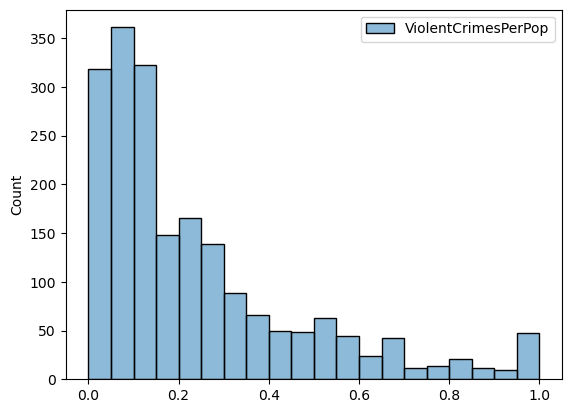

In [23]:
# Distribution of the response variable

sns.histplot(y_new, binwidth=0.05)

The response variable is right-skewed, majority of the values lower than 0.2.

For linear regression models, the transformation might be helpful to improve the linear relationship between response and independent variables. However, there are some regression models which are more flexible to estimate the non-linear relationship. Exploration is required to find out which one that can give better performance for prediction.

In [24]:
# Descriptive statistics for ViolentCrimesPerPop

y_new["ViolentCrimesPerPop"].describe(percentiles=[.01, .25, .5, .75, .99])

count    1993.000000
mean        0.237983
std         0.233043
min         0.000000
1%          0.010000
25%         0.070000
50%         0.150000
75%         0.330000
99%         1.000000
max         1.000000
Name: ViolentCrimesPerPop, dtype: float64

In [25]:
# Some observations have ViolentCrimesPerPop equal to 0

len(y_new[y_new["ViolentCrimesPerPop"]==0])

10

In [26]:
# Feature Names
features_name = X_new.columns

# No. of features
no_of_features = len(features_name)

In [27]:
# Create a figure and a 100x3 grid of subplots
fig, axes = plt.subplots(100, 3, figsize=(20, 400))

# Subplots
for i in range(no_of_features):
    # Plot Displot
    sns.histplot(ax=axes[i,0], data=X_new, x=features_name[i], binwidth=0.05)
    axes[i,0].set_title(f"{features_name[i]} | HistPlot")
    axes[i,0].set_xlabel('')
    axes[i,0].set_ylabel('')

    sns.boxplot(ax=axes[i,1], data=X_new, y=features_name[i])
    axes[i,1].set_title(f"{features_name[i]} | BoxPlot")
    axes[i,1].set_xlabel('')
    axes[i,1].set_ylabel('')

    sns.regplot(ax=axes[i,2], x=X_new[features_name[i]], y=y_new["ViolentCrimesPerPop"], ci=None, line_kws=dict(color="r"))
    axes[i,2].set_title(f"ViolentCrimesPerPop ~ {features_name[i]} | RegPlot")
    axes[i,2].set_xlabel('')
    axes[i,2].set_ylabel('')

# Adjust layout
plt.tight_layout()

# Show plot
plt.show()

- Looking at the Histrogram and Boxplot, some independent variables are skewed. As the impact, it is more challenging to validate the correlation, especially for high-density areas in the scatterplot.

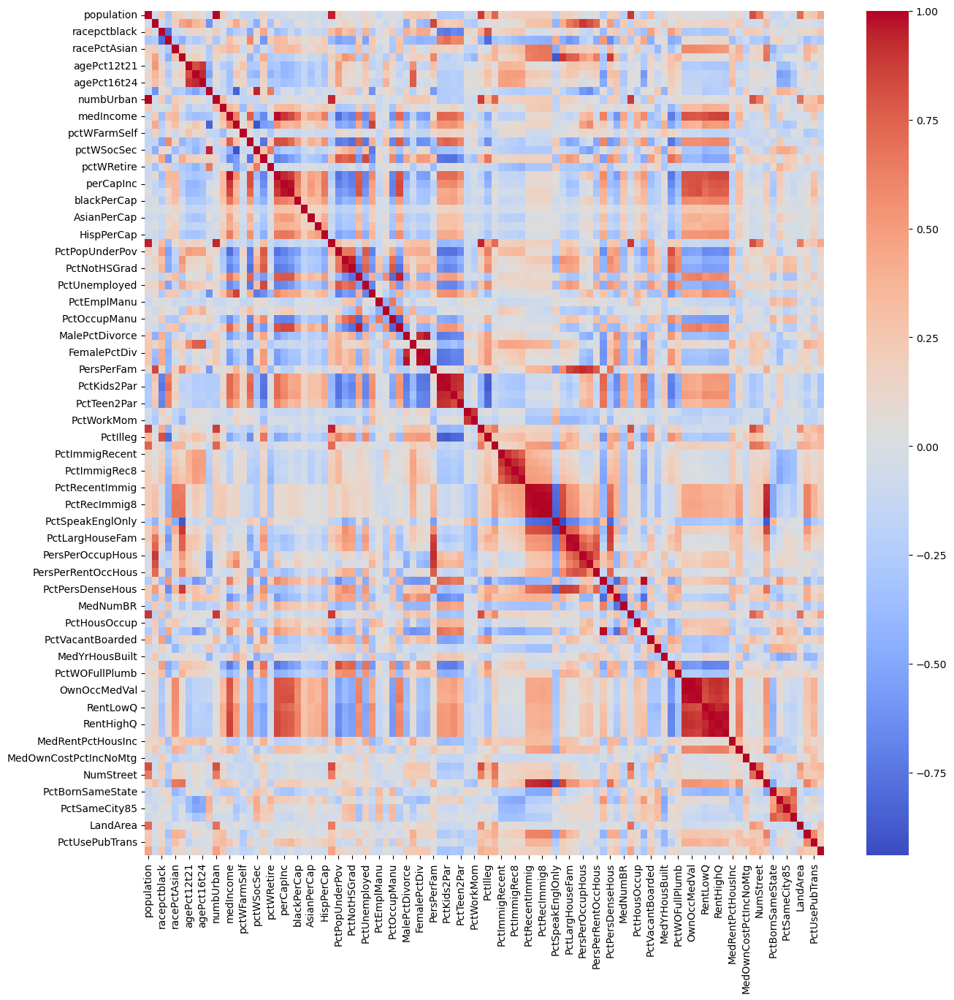

In [28]:
# Correlation between Independent Variables - Pearson

correlation_matrix = X_new.corr(method='pearson')

plt.figure(figsize=(15,15))
sns.heatmap(correlation_matrix, cmap='coolwarm')
plt.show()

The pearson correlation is the parametric approach to measure linear relationship. Excluding the diagonal, we can see some values closer to 1 (darker red) or -1 (darker blue), indicating a stronger correlation. This can lead to multicollinearity - independent variables are higly correlated.

Based on the scatterplot, some independent variables are skewed or have outliers, and Kendall's tau is more preferable for this use case. Kendall's tau is a rank correlation (non-parametric), and two variables with similar rank will have a high correlation value.

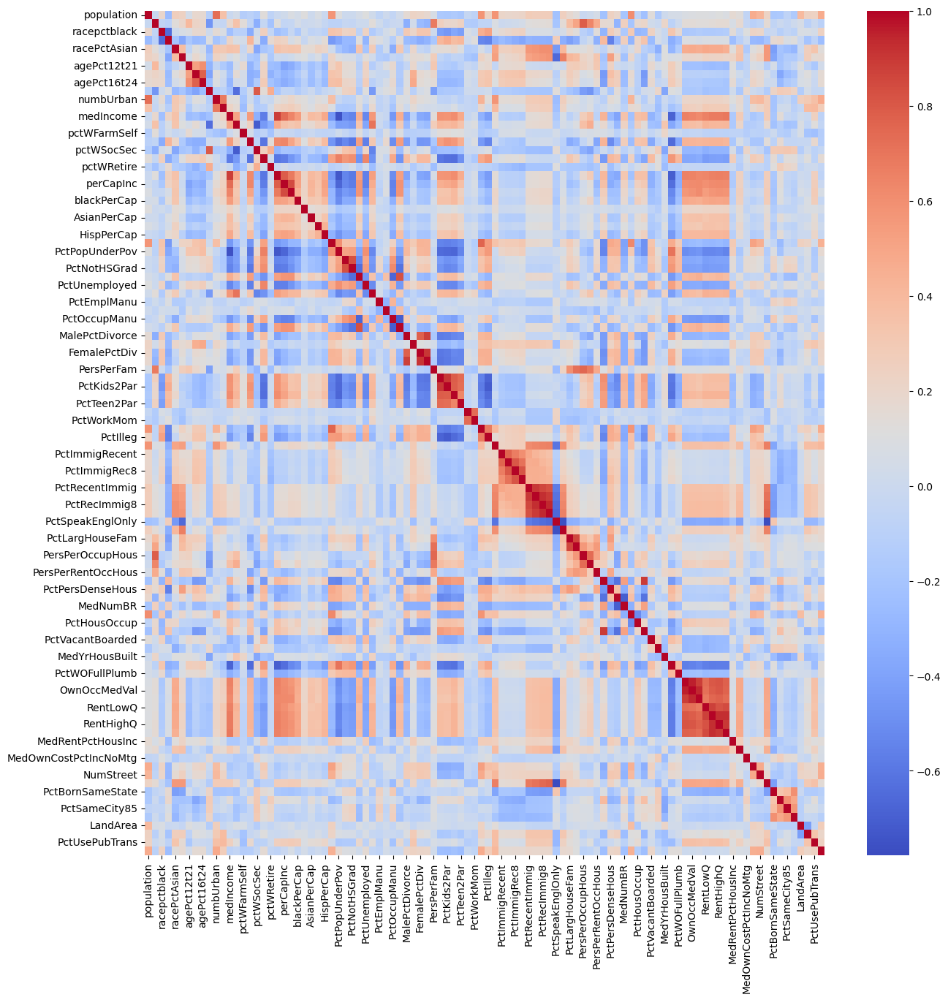

In [29]:
# Correlation between Independent Variables - Kendall's Tau

correlation_matrix = X_new.corr(method='kendall')

plt.figure(figsize=(15,15))
sns.heatmap(correlation_matrix, cmap='coolwarm')
plt.show()

- The noticeable difference is that certain values with darker colors in the Pearson heatmap have lighter colors in the Kendall's tau heatmap, indicating a potentially weaker correlation.
- We can also see some values with darker red and blue colors, indicating they are highly correlated. The values in the diagonal are excluded. 

The next step is to explore feature selection method that can resulted in more accurate regression model.

## Boxcox Transformation

In [30]:
# Remove observations with ViolentCrimesPerPop equals to 0
y_0_idx = y_new[y_new["ViolentCrimesPerPop"]==0].index.to_list()

y_new_t = y_new.drop(y_0_idx, axis=0).reset_index(drop=True)
X_new_t = X_new.drop(y_0_idx, axis=0).reset_index(drop=True)

# Transform response variable & save lambda value
y_new_transform, lmbda = stats.boxcox(y_new_t["ViolentCrimesPerPop"])

In [31]:
lmbda

0.11908089131390148

In [32]:
y_new_transform

array([-1.46460903, -0.39107834, -0.80294602, ..., -1.34825701,
       -1.50682735, -0.7028085 ])

<Axes: ylabel='Count'>

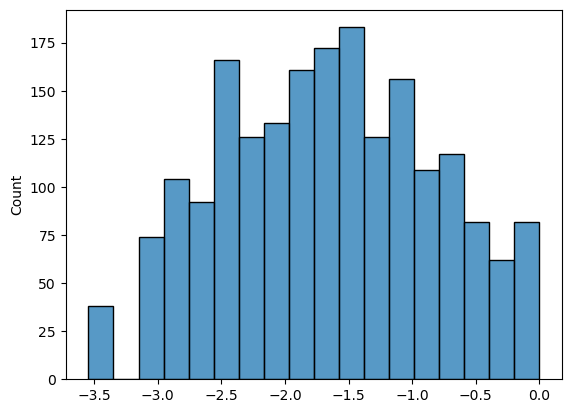

In [33]:
# Distribution of the response variable after transformation

sns.histplot(y_new_transform, binwidth=0.20)

The value of lambda that maximize the log likelihood function is 0.119xxx, but it returns unreasonable transformed values for response variable equals to 0. In this case, those observations will be removed. 

In [34]:
# Create a figure and a 100x3 grid of subplots
fig, axes = plt.subplots(100, 3, figsize=(20, 400))

# Plot on each subplot
for i in range(no_of_features):
    # Plot Displot
    sns.histplot(ax=axes[i,0], data=X_new_t, x=features_name[i], binwidth=0.05)
    axes[i,0].set_title(f"{features_name[i]} | HistPlot")
    axes[i,0].set_xlabel('')
    axes[i,0].set_ylabel('')

    sns.boxplot(ax=axes[i,1], data=X_new_t, y=features_name[i])
    axes[i,1].set_title(f"{features_name[i]} | BoxPlot")
    axes[i,1].set_xlabel('')
    axes[i,1].set_ylabel('')

    sns.regplot(ax=axes[i,2], x=X_new_t[features_name[i]], y=y_new_transform, ci=None, line_kws=dict(color="r"), fit_reg=True)
    axes[i,2].set_title(f"ViolentCrimesPerPop ~ {features_name[i]} | RegPlot")
    axes[i,2].set_xlabel('')
    axes[i,2].set_ylabel('')

# Adjust layout
plt.tight_layout()

# Show plot
plt.show()

Visually, it is clearer to see some linear relationships are apparent, but the impact of some independent variables on the transformed response variable appears to be less intuitive when the values for the response are very small. For example, racePctWhite, PctHousOwnOcc, etc.

In [35]:
y_new_transform = pd.Series(y_new_transform, name='ViolentCrimesPerPop')

# Save Preprocessed Data

In [36]:
df_new = pd.concat([X_new,y_new], axis=1)
df_new_t = pd.concat([X_new_t,y_new_transform], axis=1)

In [37]:
# Define directory
dir = "/Users/yola.kamalita/Documents/Project/Github/crimes_prediction/data"

# Ensure the directory exists
os.makedirs(dir, exist_ok=True)

In [38]:
# Save to CSV
df_new.to_csv(os.path.join(dir,'df_new.csv'), index=False)
df_new_t.to_csv(os.path.join(dir,'df_new_transform.csv'), index=False)